<center>
    <a href="https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce">
        <img src="https://storage.googleapis.com/kaggle-datasets-images/55151/105464/d59245a7014a35a35cc7f7b721de4dae/dataset-cover.png?t=2018-09-21-16-21-21" style="max-width: 300px; display: inline" alt="OpenClassrooms"/>
    </a>
</center>

<center>
    <span style="color:lightpurple; font-size: 24px; font-weight: bold;">
        PROJET DATA SCIENCE
    </span>
</center>
<br><br>
<center>
    <span style="color:black; font-size: 22px; font-weight: bold;">
        Segmenter des clients d'un site e-commerce
    </span>
</center>
<center>
    <span style="color:blue; font-size: 22px; font-weight: bold;">
        Notebook n°2 - Clustering
    </span>
</center>
<br><br>
<center>
    <span style="color:black; font-weight: bold;">
        Ambre ROBERT
    </span>
</center>
<br><br>

Olist est une entreprise brésilienne offrant une solution pour vendre sur les marketplaces en ligne.
Afin de mettre au point des campagnes de communication pertinentes, Olist souhaite comprendre les différents types d’utilisateurs de son site. 

Dans ce contexte, le projet suivant s'intéresse au comportement et aux données personnelles de ces utilisateurs. 
L'objectif est de fournir une segmentation des clients d’Olist destinée à l’équipe Marketing afin d’améliorer la communication de l’entreprise.

Ce notebook contientient toute la partie segmentation des utilisateurs. 

Pour avoir le notebook avec **toutes les sorties affichées** voir le fichier au format html.

### Librairies

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import plotly.express as px

from scipy.stats import boxcox
from scipy.spatial.distance import cdist

from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.cluster import KMeans, DBSCAN
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score
from sklearn.model_selection import ParameterGrid

from itertools import combinations

### Style des graphiques

In [2]:
sns.set(style="whitegrid")
background_color = '#2a2e3b'
title_size = 20
label_size = 14
text_color = 'white'

# 1. Table des matières
- [2. RFM](#2.-RFM)
  - [2.1 Traitement des données](#2.1-Traitement-des-données)
  - [2.2 Segmentation RFM](#2.2-Segmentation-RFM)
  - [2.3 k-means ](#2.3-k-means )
      - [2.3.1 k-means avec k=4](#2.3.1-k-means-avec-k=4)
      - [2.3.2 k-means avec k=3](#2.3.2-k-means-avec-k=3)
- [3. Ajout de variables](#3.-Ajout-de-variables)
  - [3.1 Traitement des données](#3.1-Traitement-des-données)
  - [3.2 k-means](#3.2-k-means)
      - [3.2.1 Parcourir les modèles](#3.2.1-Parcourir-les-modèles)
      - [3.2.2 1er modèle](#3.2.2-1er-modèle)
      - [3.2.3 2ème modèle](#3.2.3-2ème-modèle)
      - [3.2.4 3ème modèle](#3.2.4-3ème-modèle)
      - [3.2.5 4ème modèle](#3.2.5-4ème-modèle)
  - [3.3 DBSCAN](#3.3-DBSCAN)
- [4. Conclusion](#4.-Conclusion)

# 2. RFM

La méthode RFM est une méthode de segmentation qui prend en compte la Récence (date de la dernière commande), la Fréquence des commandes et le Montant (de la dernière commande ou sur une période donnée) pour établir des segments de clients homogènes.

## 2.1 Traitement des données

In [3]:
rfm_data = pd.read_csv('./data/rfm_data.csv')

Afin de créer le score RFM, nous devons connaitre la "Recency", la "Frequency" et la "Monetary" de chaque client. Ils sont définis comme suit :

- Recency : le nombre de jours depuis le dernier achat,

- Frequency : le nombre d'achats au cours de la durée de vie du client,

- Monetary Value : montant total des transactions du client.

In [4]:
rfm_data.rename(columns={'time_since_last_order': 'Recency', 
                         'number_of_orders': 'Frequency', 
                         'total_price': 'MonetaryValue'}, inplace=True)

rfm_data = rfm_data[["customer_unique_id", "Recency", "Frequency", "MonetaryValue"]]

In [5]:
rfm_data

,customer_unique_id,Recency,Frequency,MonetaryValue
0,0000366f3b9a7992bf8c76cfdf3221e2,115.0,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,118.0,1,27.19
2,0000f46a3911fa3c0805444483337064,541.0,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,325.0,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,292.0,1,196.89
...,...,...,...,...
95553,fffcf5a5ff07b0908bd4e2dbc735a684,451.0,1,2067.42
95554,fffea47cd6d3cc0a88bd621562a9d061,266.0,1,84.58
95555,ffff371b4d645b6ecea244b27531430a,572.0,1,112.46
95556,ffff5962728ec6157033ef9805bacc48,123.0,1,133.69


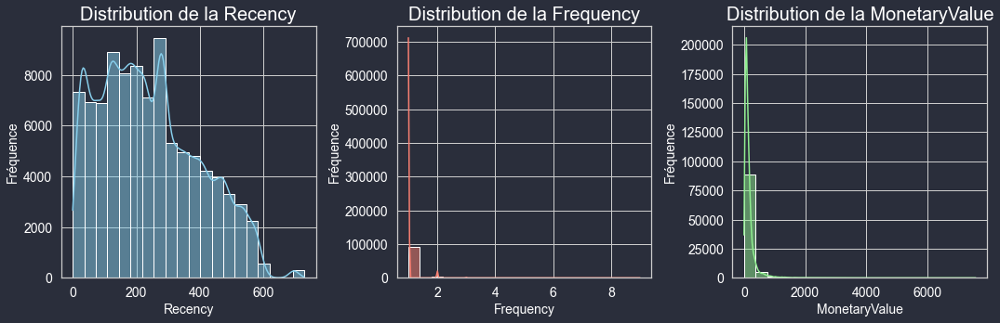

In [6]:
plt.figure(figsize=(15, 5))
plt.gcf().set_facecolor(background_color)

plt.subplot(1, 3, 1)
plt.gca().set_facecolor(background_color)
sns.histplot(rfm_data["Recency"], kde=True, bins=20, color="skyblue")
plt.title("Distribution de la Recency", fontsize=title_size, color=text_color)
plt.xlabel("Recency", fontsize=label_size, color=text_color)
plt.ylabel("Fréquence", fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)

plt.subplot(1, 3, 2)
plt.gca().set_facecolor(background_color)
sns.histplot(rfm_data["Frequency"], kde=True, bins=20, color="salmon")
plt.title("Distribution de la Frequency", fontsize=title_size, color=text_color)
plt.xlabel("Frequency", fontsize=label_size, color=text_color)
plt.ylabel("Fréquence", fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)

plt.subplot(1, 3, 3)
plt.gca().set_facecolor(background_color)
sns.histplot(rfm_data["MonetaryValue"], kde=True, bins=20, color="lightgreen")
plt.title("Distribution de la MonetaryValue", fontsize=title_size, color=text_color)
plt.xlabel("MonetaryValue", fontsize=label_size, color=text_color)
plt.ylabel("Fréquence", fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)

plt.tight_layout()
plt.show()

### Transformation

In [7]:
rfm_transformed_data = rfm_data.copy()

rfm_transformed_data["Recency"], _ = boxcox(rfm_data["Recency"] + 1)
rfm_transformed_data["Frequency"] = np.log1p(rfm_data["Frequency"])
rfm_transformed_data["MonetaryValue"], _ = boxcox(rfm_data["MonetaryValue"]+1) 

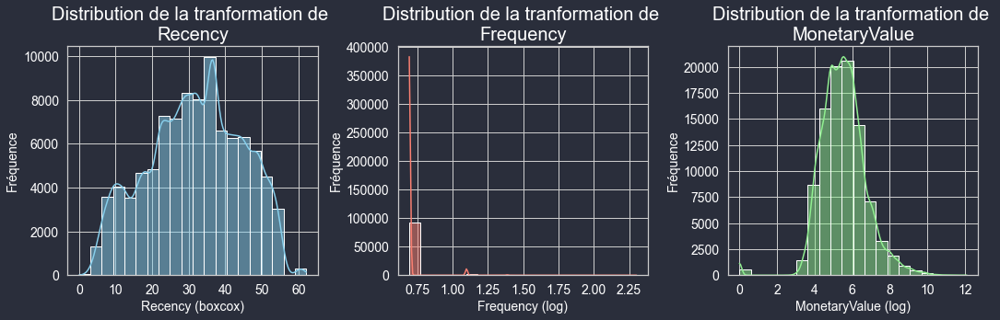

In [8]:
plt.figure(figsize=(15, 5))
plt.gcf().set_facecolor(background_color)

plt.subplot(1, 3, 1)
plt.gca().set_facecolor(background_color)
sns.histplot(rfm_transformed_data["Recency"], kde=True, bins=20, color="skyblue")
plt.title("Distribution de la tranformation de \nRecency", fontsize=title_size, color=text_color)
plt.xlabel("Recency (boxcox)", fontsize=label_size, color=text_color)
plt.ylabel("Fréquence", fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)

plt.subplot(1, 3, 2)
plt.gca().set_facecolor(background_color)
sns.histplot(rfm_transformed_data["Frequency"], kde=True, bins=20, color="salmon")
plt.title("Distribution de la tranformation de \nFrequency", fontsize=title_size, color=text_color)
plt.xlabel("Frequency (log)", fontsize=label_size, color=text_color)
plt.ylabel("Fréquence", fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)

plt.subplot(1, 3, 3)
plt.gca().set_facecolor(background_color)
sns.histplot(rfm_transformed_data["MonetaryValue"], kde=True, bins=20, color="lightgreen")
plt.title("Distribution de la tranformation de \nMonetaryValue", fontsize=title_size, color=text_color)
plt.xlabel("MonetaryValue (log)", fontsize=label_size, color=text_color)
plt.ylabel("Fréquence", fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)

plt.tight_layout()
plt.show()

### Standardisation

In [9]:
standard_scaler = StandardScaler()

rfm_std_transformed_data = rfm_transformed_data.copy()

rfm_std_transformed_data[['Recency', 'Frequency', 'MonetaryValue']] = standard_scaler.fit_transform(
    rfm_std_transformed_data[['Recency', 'Frequency', 'MonetaryValue']]
)

In [10]:
rfm_std_transformed_data_red = rfm_std_transformed_data[["Recency", "Frequency", "MonetaryValue"]]

## 2.2 Segmentation RFM

### Calculs des scores

Afin d'obtenir les scores RFM individuels nous allons utiliser la méthode statistique en utilisant les quantiles.

Le classement des scores RFM individuels est effectué en divisant chacune des valeurs RFM en quantiles, ce qui crée cinq tranches plus ou moins égales. Nous classons ensuite chaque compartiment de un à cinq ; cinq étant le meilleur.

Par exemple, une "Recency" (R) de 1 (le score le plus bas) représente les clients inactifs depuis un certain temps. Une "Frequency" de de 5 (le score le plus élevé) correspond aux acheteurs les plus fréquents, etc.

In [11]:
rfm = rfm_std_transformed_data.copy() 

quantiles = rfm.quantile(q=[0.2,0.4,0.6,0.8])
quantiles = quantiles.to_dict()
    
def RScore(x,p,d):
    if x <= d[p][0.2]:
        return 5
    elif x <= d[p][0.4]:
        return 4
    elif x <= d[p][0.6]: 
        return 3
    elif x <= d[p][0.8]: 
        return 2
    else:
        return 1   
    
def FMScore(x,p,d):
    if x <= d[p][0.2]:
        return 1
    elif x <= d[p][0.4]:
        return 2
    elif x <= d[p][0.6]: 
        return 3
    elif x <= d[p][0.8]: 
        return 4
    else:
        return 5
    
rfm['R'] = rfm['Recency'].apply(RScore, args=('Recency',quantiles,))
rfm['F'] = rfm['Frequency'].apply(FMScore, args=('MonetaryValue',quantiles,)) 
rfm['M'] = rfm['MonetaryValue'].apply(FMScore, args=('MonetaryValue',quantiles,))

**Calculer le score RFM global**

Cela peut se faire de deux manières :

- Concaténation : crée des segments

Ici, nous concaténons les scores RFM individuel comme des chaînes et obtenons des segments étiquetés en retour. Notre meilleur segment sera de 555 et notre pire sera de 111 (ce qui signifie le score le plus bas dans les trois catégories RFM).

- Addition : crée un score 

Ici, nous additionnons les scores RFM individuels comme des nombres et obtenons en retour un nombre indiquant le score du client. Le score variera de 3 à 15.

In [12]:
def join_rfm(x): return str(x['R']) + str(x['F']) + str(x['M'])
rfm['RFM_Segment'] = rfm.apply(join_rfm, axis=1)

rfm['RFM_Score'] = rfm[['R','F','M']].sum(axis=1)

- **Segment**

In [13]:
rfm['RFM_Segment'].unique()

array(['434', '431', '132', '231', '234', '335', '134', '433', '131',
       '233', '432', '331', '235', '532', '531', '535', '135', '133',
       '333', '533', '534', '334', '232', '435', '355', '332', '454',
       '553', '153', '455', '555', '255', '155', '452', '253', '354',
       '554', '353', '551', '152', '552', '254', '453', '154', '352',
       '351', '252', '251', '151', '451'], dtype=object)

Nous pouvons alors créer des segments de clientèle exploitables et faciles à comprendre, comme ceux ci-dessous :

|   Segment clientèle |   Interprétation    |
|---|---|
|   Champion   |   Les meilleurs clients, ils achètent et dépensent beaucoup et ont effectué leur dernier achat récemment. |   
|   Loyal customers   |   Clients récents et fréquents. |   
|   Potential loyalists   |   Des clients récents, mais qui ont déjà beaucoup dépensé. |   
|   Recent customers   |   Clients récents, qui n’ont effectué que quelques achats. |   
|   Promising   |   Clients qui achètent fréquemment et dépensent beaucoup, mais qui ont effectué leur dernier achat il y a quelque temps. |   
|   Need attention   |   Clients récents avec des dépenses supérieures à la moyenne, mais une faible fréquence.|
|   At risk   |   Clients qui achètent fréquemment, mais qui n’ont effectué aucun achat depuis longtemps. |   
|   Can't lose them   |   Des clients qui ont beaucoup acheté, mais qui sont inactifs depuis longtemps. |
|   Hibernating   |   Clients peu fréquents et peu dépensiers qui n’ont pas acheté depuis longtemps. |
|   Lost   |   Ils n'ont pas acheté depuis longtemps, ils n'ont acheté qu'une fois (ou très peu de fois) et ils ont très peu dépensé. |

In [14]:
segt_map = {
    r'[4-5][4-5][4-5]': 'Champions',  
    r'[3-5][4-5][1-5]': 'Loyal customers',  
    r'[4-5][2-4][3-5]': 'Potential loyalists',  
    r'[4-5][1-3][1-3]': 'Recent customers',  
    r'[1-3][3-5][3-5]': 'Promising',  
    r'[4-5][1-2][3-5]': 'Need attention',  
    r'[1-3][3-5][2-5]': 'At risk',  
    r'[1-2][3-5][4-5]': "Can't lose them", 
    r'[1-2][1-3][1-2]': 'Hibernating',  
    r'1 1 1': 'Lost'  
}

rfm['Segment'] = rfm['R'].map(str) + rfm['F'].map(str) + rfm['M'].map(str)
rfm['Segment'] = rfm['Segment'].replace(segt_map, regex=True)

rfm['Segment'] = rfm['Segment'].replace({'151': 'Can\'t lose them', '251': 'Can\'t lose them', 
                                         '331': 'Promising'})

- **Score**

In [15]:
rfm['Score'] = 'Iron'                                  
rfm.loc[rfm['RFM_Score'] > 7, 'Score'] = 'Bronze'       
rfm.loc[rfm['RFM_Score'] > 9, 'Score'] = 'Silver'       
rfm.loc[rfm['RFM_Score'] > 11, 'Score'] = 'Gold'        
rfm.loc[rfm['RFM_Score'] > 13, 'Score'] = 'Platinum'

- **Représentations graphiques**

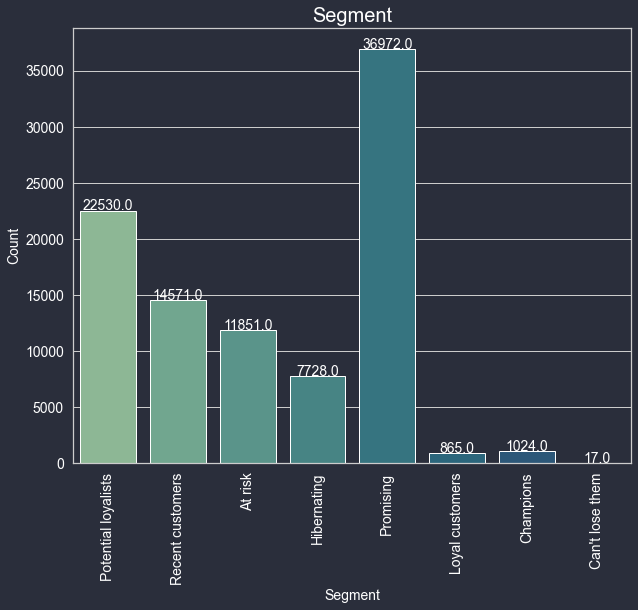

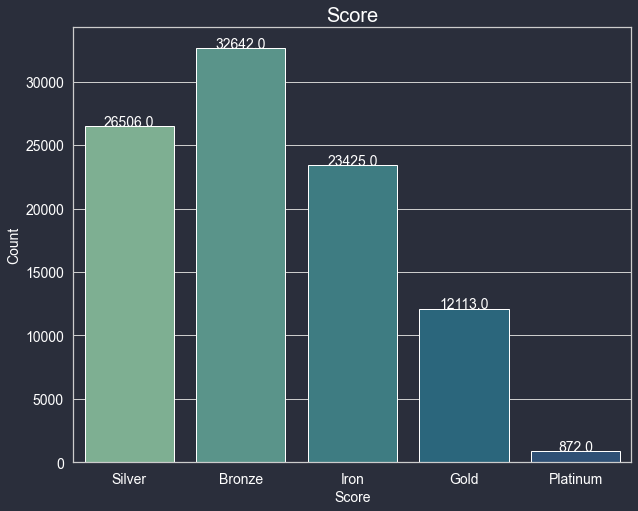

In [16]:
fig1 = rfm.groupby(['Segment']).count().unstack().fillna(0)
fig2 = rfm.groupby(['Score']).count().unstack().fillna(0)

palette = "crest"      

# Segment
plt.figure(figsize=(10, 8))
plt.gcf().set_facecolor(background_color)
ax1 = plt.gca()
ax1.set_facecolor(background_color)

sns.countplot(x='Segment', data=rfm, palette=palette, ax=ax1)
ax1.set_title('Segment', fontsize=title_size, color=text_color)
ax1.set_ylabel('Count', fontsize=label_size, color=text_color)
ax1.set_xlabel('Segment', fontsize=label_size, color=text_color)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
ax1.tick_params(colors=text_color, labelsize=label_size)

for p in ax1.patches:
    ax1.annotate('{:.1f}'.format(p.get_height()), 
                 (p.get_x() + p.get_width() / 2, p.get_height() + 20),
                 ha='center', color=text_color, fontsize=label_size)

plt.show()

# Score
plt.figure(figsize=(10, 8))
plt.gcf().set_facecolor(background_color)
ax2 = plt.gca()
ax2.set_facecolor(background_color)

sns.countplot(x='Score', data=rfm, palette=palette, ax=ax2)
ax2.set_title('Score', fontsize=title_size, color=text_color)
ax2.set_ylabel('Count', fontsize=label_size, color=text_color)
ax2.set_xlabel('Score', fontsize=label_size, color=text_color)
ax2.tick_params(colors=text_color, labelsize=label_size)

for p in ax2.patches:
    ax2.annotate('{:.1f}'.format(p.get_height()), 
                 (p.get_x() + p.get_width() / 2, p.get_height() + 20),
                 ha='center', color=text_color, fontsize=label_size)

plt.show()

In [17]:
fig3 = rfm.groupby('Segment').agg({'customer_unique_id': lambda x: len(x)}).reset_index()

fig3.rename(columns={'customer_unique_id': 'Count'}, inplace=True)
fig3['percent'] = (fig3['Count'] / fig3['Count'].sum()) * 100
fig3['percent'] = fig3['percent'].round(1)


crest_palette = sns.color_palette("coolwarm", n_colors=8)  
colors = [mcolors.to_hex(color) for color in crest_palette]

segment_colors = {
    'Champions': colors[0],  
    'Loyal customers': colors[1],  
    'Potential loyalists': colors[2],  
    'Recent customers': colors[3],  
    'Promising': colors[4],  
    'At risk': colors[5],  
    'Can\'t lose them': colors[6],  
    'Hibernating': colors[7]   
}

fig = px.treemap(
    fig3, 
    path=['Segment'], 
    values='Count',
    width=800, 
    height=400,
    title="RFM Segments",
    color='Segment',  
    color_discrete_map=segment_colors  
)

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="RFM Segments", font=dict(size=20, color='white')),  
    margin=dict(t=50, l=25, r=25, b=25)
)

fig.data[0].textinfo = 'label+text+value+percent root'  

fig.show()

In [18]:
fig4 = rfm.groupby('Score').agg({'customer_unique_id': lambda x: len(x)}).reset_index()

fig4.rename(columns={'customer_unique_id': 'Count'}, inplace=True)
fig4['percent'] = (fig4['Count'] / fig4['Count'].sum()) * 100
fig4['percent'] = fig4['percent'].round(1)

score_colors = {
    'Platinum': colors[0],     
    'Gold': colors[1],  
    'Silver': colors[2],     
    'Bronze': colors[3],  
    'Iron': colors[4]
}

fig = px.treemap(
    fig4, 
    path=['Score'], 
    values='Count',
    width=800, 
    height=400,
    title="Treemap des Score RFM",
    color='Score',  
    color_discrete_map=score_colors  
)

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Treemap des Score RFM", font=dict(size=20, color='white')),  
    margin=dict(t=50, l=25, r=25, b=25)
)

fig.data[0].textinfo = 'label+text+value+percent root'  

fig.show()

In [19]:
fig5 = rfm.groupby(['Segment', 'Score']).agg({'customer_unique_id': lambda x: len(x)}).reset_index()

fig5.rename(columns={'customer_unique_id': 'Count'}, inplace=True)
fig5['percent'] = (fig5['Count'] / fig5['Count'].sum()) * 100
fig5['percent'] = fig5['percent'].round(1)

fig5.head()
crest_palette = sns.color_palette("coolwarm", n_colors=8)  
colors_palette = [mcolors.to_hex(color) for color in crest_palette]
colors=[colors_palette[4], colors_palette[2] , colors_palette[3] , colors_palette[5], colors_palette[7], colors_palette[0] , colors_palette[1] , colors_palette[6]] #color palette

fig = px.treemap(fig5, path=[px.Constant("Customer"), 'Segment', 'Score'], values='Count'
                ,title="Treemap des Segmentations clients")
fig.update_traces(root_color="lightgrey")  
fig.update_layout(
    margin=dict(t=50, l=25, r=25, b=25),
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white')  
)

fig.update_layout(
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

## 2.3 k-means 

Nous allons maintenant appliquer un algorithme de clustering : **k-means**.

In [20]:
def plot_elbow_and_silhouette(data, background_color, text_color, title_size, label_size):
    plt.figure(figsize=(12, 8))
    plt.gca().set_facecolor(background_color)
    
    K = range(2, 20)
    distortions = []
    inertias = []
    silhouette_scores = []
    mapping1 = {}
    sse = {}

    for k in K:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data)
        
        distortions.append(
            sum(np.min(cdist(data, kmeans.cluster_centers_, 'euclidean'), axis=1)) / data.shape[0]
        )
        inertias.append(kmeans.inertia_)
        silhouette_scores.append(silhouette_score(data, kmeans.labels_))
        mapping1[k] = distortions[-1]
        sse[k] = kmeans.inertia_

    # Elbow method
    plt.subplot(1, 2, 1)  
    plt.title('Elbow Method', fontsize=title_size, color=text_color)
    plt.xlabel('k', fontsize=label_size, color=text_color)
    plt.ylabel('SSE', fontsize=label_size, color=text_color)
    plt.xticks(color=text_color, fontsize=label_size)
    plt.yticks(color=text_color, fontsize=label_size)
    plt.gcf().set_facecolor(background_color)

    sns.pointplot(x=list(sse.keys()), y=list(sse.values()), color='skyblue')

    # Silhouette Scores
    plt.subplot(1, 2, 2)  
    plt.title('Silhouette Scores', fontsize=title_size, color=text_color)
    plt.xlabel('k', fontsize=label_size, color=text_color)
    plt.ylabel('Silhouette Score', fontsize=label_size, color=text_color)
    plt.xticks(color=text_color, fontsize=label_size)
    plt.yticks(color=text_color, fontsize=label_size)

    sns.pointplot(x=list(K), y=silhouette_scores, color='coral')

    plt.tight_layout()
    plt.show()

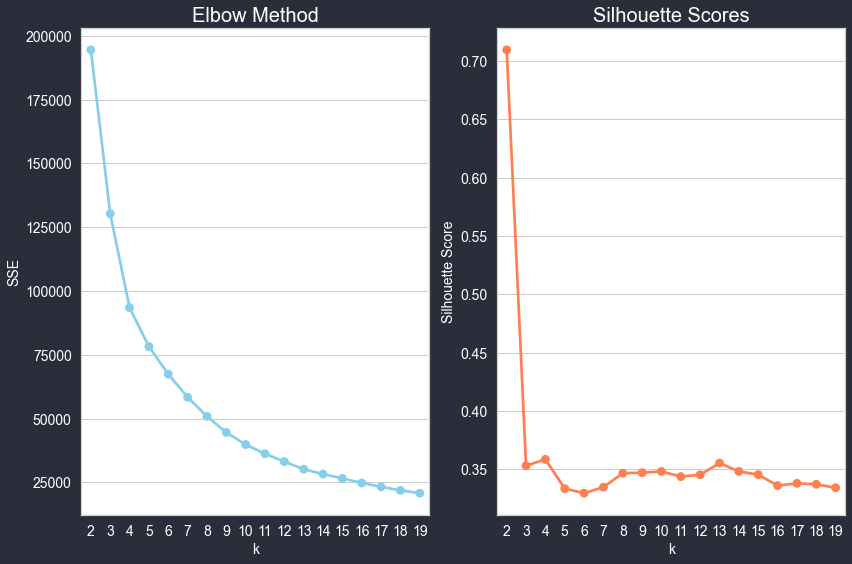

In [21]:
plot_elbow_and_silhouette(rfm_std_transformed_data_red, background_color, text_color, title_size, label_size)

D'après ces graphiques nous pouvons prendre un nombre de clusters k=3 ou k=4. 

### 2.3.1 k-means avec k=4

In [22]:
model = KMeans(n_clusters=4, random_state=42)
model.fit(rfm_std_transformed_data_red)
model.labels_.shape

rfm_data["Cluster"] = model.labels_
rfm_data.head()
rfm_data.groupby('Cluster').agg({
    'Recency':'mean',
    'Frequency':'mean',
    'MonetaryValue':['mean', 'count']}).round(1)

Recency Frequency MonetaryValue       
           mean      mean          mean  count
Cluster                                       
0         356.2       1.0          75.0  36004
1          92.8       1.0         108.5  32423
2         225.8       2.1         305.8   2923
3         278.0       1.0         355.8  24208

In [23]:
df_normalized = pd.DataFrame(rfm_std_transformed_data_red, columns=['Recency', 'Frequency', 'MonetaryValue'])
df_normalized['ID'] = rfm_data.index
df_normalized['Cluster'] = model.labels_


fig6 = df_normalized.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()

fig6.rename(columns={'ID': 'Count'}, inplace=True)
fig6['percent'] = (fig6['Count'] / fig6['Count'].sum()) * 100
fig6['percent'] = fig6['percent'].round(1)

colors=['#bad0af','#d5e0cf','#f1f1f1','#f1d4d4'] 

fig = px.treemap(fig6, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution cluster")

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Distribution cluster", font=dict(size=20, color='white')), 
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

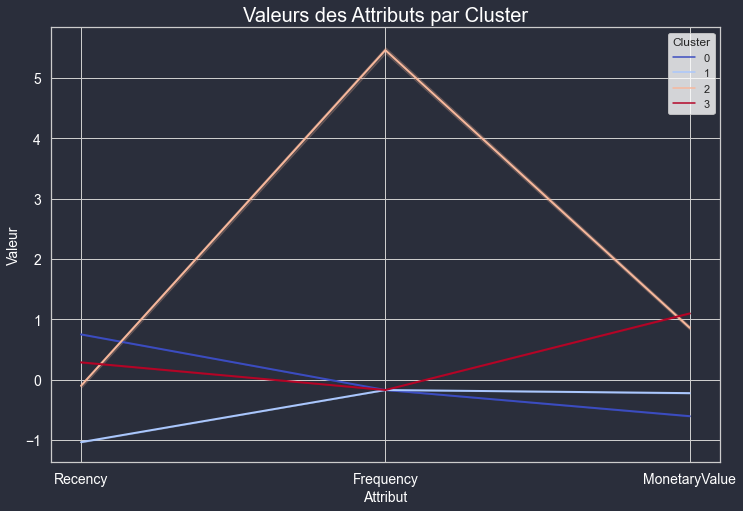

In [24]:
df_nor_melt = pd.melt(df_normalized.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['Recency','Frequency','MonetaryValue'],
                      var_name='Attribute',
                      value_name='Value')

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt, palette="coolwarm", linewidth=2 )

plt.title('Valeurs des Attributs par Cluster', fontsize=title_size, color=text_color)
plt.xlabel('Attribut', fontsize=label_size, color=text_color)
plt.ylabel('Valeur', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

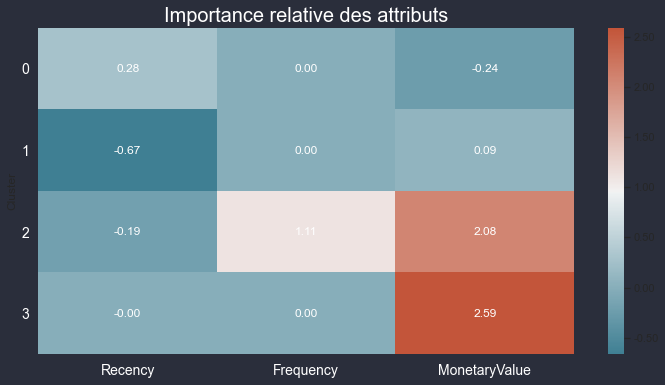

In [25]:
cluster_avg = rfm_data[['Cluster','Recency','Frequency','MonetaryValue']].groupby(['Cluster']).mean()
population_avg = rfm_data[['Recency','Frequency','MonetaryValue']].head().mean()

relative_imp = cluster_avg / population_avg - 1
relative_imp.round(2)

cmap = sns.diverging_palette(220, 20, as_cmap=True)

plt.figure(figsize=(12, 6))
plt.gca().set_facecolor(background_color)

sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap=cmap, 
            cbar_kws={'format': '%.2f'}, annot_kws={'color': text_color})

plt.title('Importance relative des attributs', fontsize=title_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size, rotation=0)
plt.gcf().set_facecolor(background_color)

plt.show()

In [26]:
rfm_fig = rfm_data.copy()

rfm_fig['Cluster'] = rfm_fig['Cluster'].astype(str)

fig = px.scatter_3d(rfm_fig,x='Recency', y='Frequency', z='MonetaryValue',
              color='Cluster', opacity=0.7,color_discrete_sequence=px.colors.qualitative.G10)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

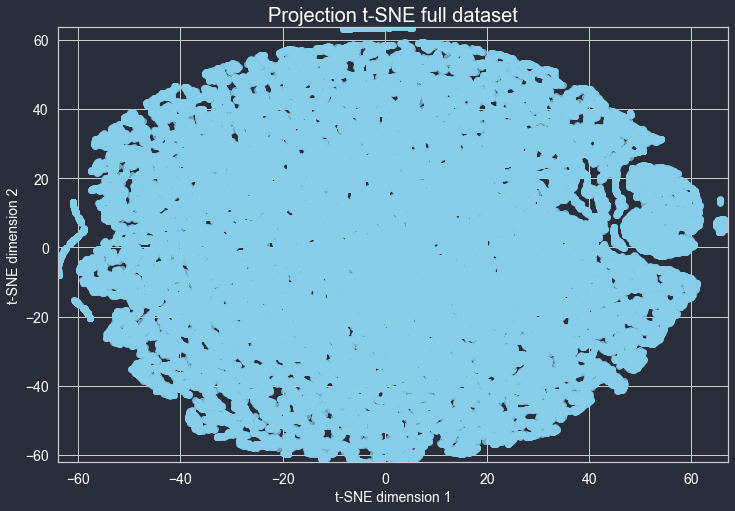

In [27]:
point_color = 'skyblue'

tsne = TSNE(n_components=2, init='pca', n_jobs=-1, random_state=42)
X_trans = tsne.fit_transform(rfm_std_transformed_data_red)

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

plt.scatter(X_trans[:, 0], X_trans[:, 1], color=point_color, alpha=0.7)

plt.xlim([np.min(X_trans[:, 0]), np.max(X_trans[:, 0])])
plt.ylim([np.min(X_trans[:, 1]), np.max(X_trans[:, 1])])

plt.title('Projection t-SNE full dataset', fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

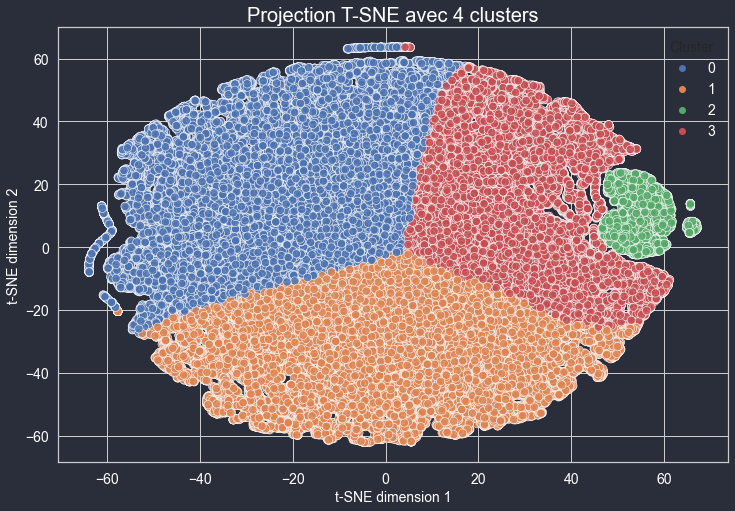

In [28]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

X_trans = pd.DataFrame(X_trans)
X_trans["cluster"] = model.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec 4 clusters", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

In [29]:
silhouette_avg = silhouette_score(rfm_std_transformed_data_red, model.labels_)
print(f"Coefficient de silhouette : {silhouette_avg:.4f}")

Coefficient de silhouette : 0.3586


- **Lien avec la segmentation RFM**

In [30]:
rfm_data_red = rfm_data[['customer_unique_id', 'Cluster']]
merged_rfm_km4 = pd.merge(rfm, rfm_data_red, on = 'customer_unique_id', how = "left")


fig7 = merged_rfm_km4.groupby(['Cluster', 'Segment', 'Score']).agg({'customer_unique_id': lambda x: len(x)}).reset_index()

fig7.rename(columns={'customer_unique_id': 'Count'}, inplace=True)
fig7['percent'] = (fig7['Count'] / fig7['Count'].sum()) * 100
fig7['percent'] = fig7['percent'].round(1)

fig7.head()
colors_palette = [mcolors.to_hex(color) for color in crest_palette]
colors=[colors_palette[0], colors_palette[2] , colors_palette[3] , colors_palette[4]]

fig = px.treemap(fig7, path=[px.Constant("Customer"), 'Cluster', 'Segment', 'Score'], values='Count'
                ,title="Treemap des Segmentations clients")
fig.update_traces(root_color="lightgrey")
fig.update_layout(
    margin=dict(t=50, l=25, r=25, b=25),
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white')  
)

fig.update_layout(
    treemapcolorway = colors, #
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

|   Cluster |   Type de clients    |   %    |   Label RFM    |   Interprétation    |   Actions à mener    |
|---|---|---|---|---|---|
|   0   |  Clients à risque  |   38%  |   46% Promising; 32% At Risk; 21% Hibernating   |  Clients qui ont effectué leur dernière transaction il y a longtemps et qui ont effectué peu d'achats. Il pourrait donc s'agir du groupe des clients à risques/perdus.   |   envoyer des e-mails personnalisés pour renouer ; proposer d'autres produits pertinents et des remises spéciales ; relancer l'intérêt avec une campagne de sensibilisation   |   
|   1   |  Nouveaux clients  |   34%  |  52% Potential loyalist; 44% Recent Customers   |  Clients ayant effectué des transactions récemment et ayant une fréquence d'achat plus faible, avec un faible montant de dépenses. Selon la segmentation RFM, la moitié d'entre eux sont des potentiels clients fidèles.   |  leur donner un succès rapide ; commencer à construire une relation   |   
|   2   |  Clients Loyaux  |  3%   |  35% Champions; 32% Promising; 30% Loyal customers   |  Les clients les plus fréquents ayant le montant dépensé le plus élevé et ayant effectué une commande récemment.   |   demander des avis ; les récompenser  | 
|   3   |  Clients prometteurs  |   25%  |  76% Promising; 24% Potential loyalist   |  Clients qui achètent fréquemment et dépensent beaucoup, mais qui ont effectué leur dernier achat il y a quelque temps.   |   faire des offres à durée limitée ; offrir des échantillons de produits gratuits  |    

### 2.3.2 k-means avec k=3

In [31]:
model_bis = KMeans(n_clusters=3, random_state=42)
model_bis.fit(rfm_std_transformed_data_red)
model_bis.labels_.shape

rfm_data["Cluster"] = model_bis.labels_
rfm_data.head()
rfm_data.groupby('Cluster').agg({
    'Recency':'mean',
    'Frequency':'mean',
    'MonetaryValue':['mean', 'count']}).round(1)

Recency Frequency MonetaryValue       
           mean      mean          mean  count
Cluster                                       
0         108.9       1.0         178.1  42536
1         225.8       2.1         305.8   2923
2         357.9       1.0         144.8  50099

In [32]:
df_normalized_bis = pd.DataFrame(rfm_std_transformed_data_red, columns=['Recency', 'Frequency', 'MonetaryValue'])
df_normalized_bis['ID'] = rfm_data.index
df_normalized_bis['Cluster'] = model_bis.labels_

fig8 = df_normalized_bis.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()

fig8.rename(columns={'ID': 'Count'}, inplace=True)
fig8['percent'] = (fig8['Count'] / fig8['Count'].sum()) * 100
fig8['percent'] = fig8['percent'].round(1)

colors=['#bad0af','#d5e0cf','#f1f1f1','#f1d4d4'] 

fig = px.treemap(fig8, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution cluster")

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Distribution cluster", font=dict(size=20, color='white')), 
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

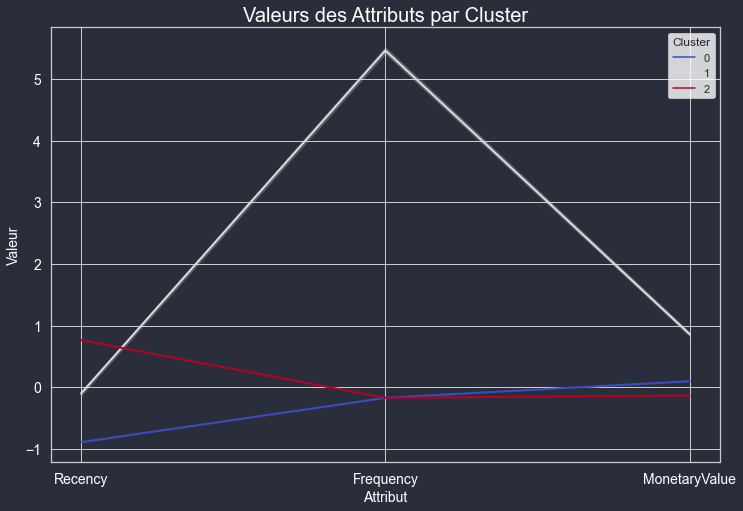

In [33]:
df_nor_melt_bis = pd.melt(df_normalized_bis.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['Recency','Frequency','MonetaryValue'],
                      var_name='Attribute',
                      value_name='Value')

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt_bis, palette="coolwarm", linewidth=2 )

plt.title('Valeurs des Attributs par Cluster', fontsize=title_size, color=text_color)
plt.xlabel('Attribut', fontsize=label_size, color=text_color)
plt.ylabel('Valeur', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

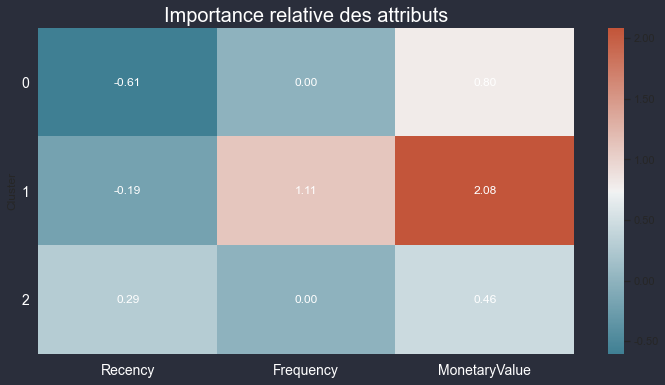

In [34]:
cluster_avg_bis = rfm_data[['Cluster','Recency','Frequency','MonetaryValue']].groupby(['Cluster']).mean()
population_avg_bis = rfm_data[['Recency','Frequency','MonetaryValue']].head().mean()

relative_imp_bis = cluster_avg_bis / population_avg_bis - 1
relative_imp_bis.round(2)

cmap = sns.diverging_palette(220, 20, as_cmap=True)

plt.figure(figsize=(12, 6))
plt.gca().set_facecolor(background_color)

sns.heatmap(data=relative_imp_bis, annot=True, fmt='.2f', cmap=cmap, 
            cbar_kws={'format': '%.2f'}, annot_kws={'color': text_color})

plt.title('Importance relative des attributs', fontsize=title_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size, rotation=0)
plt.gcf().set_facecolor(background_color)

plt.show()

In [35]:
rfm_fig = rfm_data.copy()

rfm_fig['Cluster'] = rfm_fig['Cluster'].astype(str)

fig = px.scatter_3d(rfm_fig,x='Recency', y='Frequency', z='MonetaryValue',
              color='Cluster', opacity=0.7,color_discrete_sequence=px.colors.qualitative.G10)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

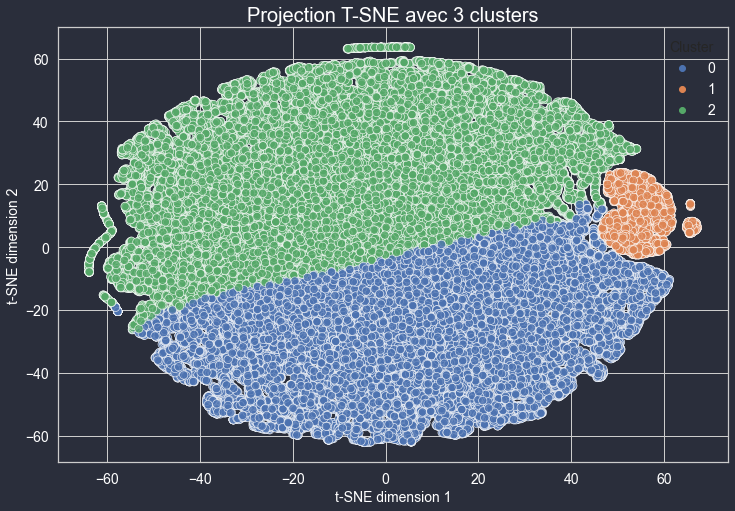

In [36]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

X_trans["cluster"] = model_bis.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec 3 clusters", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

In [37]:
silhouette_avg_bis = silhouette_score(rfm_std_transformed_data_red, model_bis.labels_)
print(f"Coefficient de silhouette : {silhouette_avg_bis:.4f}")

Coefficient de silhouette : 0.3531


- **Lien avec la segmentation RFM**

In [38]:
rfm_data_red_bis = rfm_data[['customer_unique_id', 'Cluster']]
merged_rfm_km3 = pd.merge(rfm, rfm_data_red_bis, on = 'customer_unique_id', how = "left")

fig9 = merged_rfm_km3.groupby(['Cluster', 'Segment', 'Score']).agg({'customer_unique_id': lambda x: len(x)}).reset_index()

fig9.rename(columns={'customer_unique_id': 'Count'}, inplace=True)
fig9['percent'] = (fig9['Count'] / fig9['Count'].sum()) * 100
fig9['percent'] = fig9['percent'].round(1)

fig9.head()
crest_palette = sns.color_palette("coolwarm", n_colors=3)  
colors = [mcolors.to_hex(color) for color in crest_palette]

fig = px.treemap(fig9, path=[px.Constant("Customer"), 'Cluster', 'Segment', 'Score'], values='Count'
                ,title="Treemap des Segmentations clients")
fig.update_traces(root_color="lightgrey")
fig.update_layout(
    margin=dict(t=50, l=25, r=25, b=25),
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white')  
)

fig.update_layout(
    treemapcolorway = colors, #
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

|   Cluster |   Type de clients    |   %    |   Label RFM    |   Interprétation RFM    |   Actions à mener    |
|---|---|---|---|---|---|
|   0   |  Nouveaux clients  |   45%  |   53% potential loyalist, 34% recent customers  |  Clients avec les commandes les plus récentes mais qui n'ont pas commandé ni dépensé beaucoup.   |   faire des offres à durée limitée ; offrir des échantillons de produits gratuits  | 
|   1   |  Bons clients  |   3%  |  35% champions, 32% promising, 30% loyal customers   |  Clients qui ont le plus dépensé et qui commandent fréquement.   |  demander des avis ; les récompenser   |  
|   2   |  Clients ayant besoin d'attention  |   52%  |  62% promising, 22% at risk, 15% hibernating  |  Clients qui n'ont pas commandé depuis un moment et qui n'ont pas dépensé beaucoup d'argent.   |  envoyer des e-mails personnalisés pour renouer ; proposer d'autres produits pertinents et des remises spéciales ; relancer l'intérêt avec une campagne de sensibilisation   |         

### Conclusion k-means

Pour les deux cas étudiés (k-means avec k=4 et k-means avec k=3), on observe un score silhouette équivalent. D'un point de vue métier, il serait probablement préférable de choisir le modèle k-means avec k=4, car un cluster supplémentaire permettrait une précision accrue dans la catégorisation des clients, tout en offrant une meilleure compréhension de leurs comportements.

# 3. Ajout de variables

Nous allons, dans la suite, inclure des variables créées dans le notebook précédent.

## 3.1 Traitement des données

In [39]:
customers = pd.read_csv('./data/customers.csv')

In [40]:
data = customers[['customer_unique_id', 'number_of_orders', 'total_price', 'time_since_last_order',
                  'number_of_products','average_number_products_per_order', 'average_delivery_time',
                  'average_product_volume', 'average_review_score', 'review_comment', 'delayed']]

In [41]:
data_bis = data.copy()

log_columns = ['total_price', 'time_since_last_order', 'average_delivery_time',
               'average_product_volume']
for col in log_columns:
        data_bis[col] = np.log1p(data_bis[col])  # log(x + 1)

## 3.2 k-means

### 3.2.1 Parcourir les modèles

Le code suivant permet de parcourir les modèles possibles en ajoutant au moins une variable à nos variables RFM précédentes.

In [ ]:
data0 = data_bis.drop(columns=['customer_unique_id'])

def test_kmeans_with_optimal_clusters(data, variable_combination, max_clusters=8):
    selected_data = data[list(variable_combination)]

    # Standardisation des données
    scaler = StandardScaler()
    standardized_data = scaler.fit_transform(selected_data)

    # Recherche du meilleur nombre de clusters
    best_score = -1
    optimal_clusters = 2
    for n_clusters in range(3, max_clusters + 1):
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        labels = kmeans.fit_predict(standardized_data)
        score = silhouette_score(standardized_data, labels)
        if score > best_score:
            best_score = score
            optimal_clusters = n_clusters

    return best_score, optimal_clusters

mandatory_variables = {'time_since_last_order', 'number_of_orders'} # Variables obligatoires

data_columns = set(data0.columns)
remaining_columns = data_columns - mandatory_variables

results = []

# Générer les combinaisons avec au moins 4 variables incluant les variables obligatoires
for i in range(4, len(data_columns) + 1):
    for combo in combinations(remaining_columns, i - len(mandatory_variables)):
        combo_with_mandatory = mandatory_variables.union(combo)
        if len(combo_with_mandatory) == i:
            score, optimal_clusters = test_kmeans_with_optimal_clusters(data0, combo_with_mandatory, max_clusters=8)
            results.append({
                'variables': combo_with_mandatory,
                'silhouette_score': score,
                'optimal_clusters': optimal_clusters
            })

results = sorted(results, key=lambda x: x['silhouette_score'], reverse=True)

best_combinations = pd.DataFrame(results).head(5)

print(best_combinations)

In [ ]:
#results.to_csv('results.csv', index=False)

Les résultats vont nous permettre de sélectionner plusieurs modèles que nous allons étudier plus en détail dans la suite.

### 3.2.2 1er modèle

**k-means avec 4 variables et k = 3**

In [42]:
data1 = data[['customer_unique_id', 'number_of_orders', 'total_price', 'time_since_last_order', 
              'average_number_products_per_order']]

In [43]:
def transform_data(data, log_columns, standardize_columns):
    data_transformed = data.copy()
    
    for col in log_columns:
        data_transformed[col] = np.log1p(data_transformed[col])  # log(x + 1)
    
    standard_scaler = StandardScaler()
    data_transformed[standardize_columns] = standard_scaler.fit_transform(data_transformed[standardize_columns])
    
    data_transformed = data_transformed[standardize_columns]
    
    return data_transformed

In [44]:
log_columns = ["time_since_last_order", "total_price"]
standardize_columns = ["number_of_orders", "total_price", "time_since_last_order", 
                       "average_number_products_per_order"]

data_transformed1 = transform_data(data1, log_columns, standardize_columns)

In [45]:
model1 = KMeans(n_clusters=3, random_state=42)
model1.fit(data_transformed1)
model1.labels_.shape

data1["Cluster"] = model1.labels_
data1.head()
data1.groupby('Cluster').agg({
    'time_since_last_order':'mean',
    'number_of_orders':'mean',
    'average_number_products_per_order':'mean',
    'total_price':['mean', 'count']}).round(1)

<ipython-input-45-4e4c64764181>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



time_since_last_order number_of_orders  \
                         mean             mean   
Cluster                                          
0                       242.1              1.0   
1                       225.3              2.1   
2                       240.4              1.0   

        average_number_products_per_order total_price         
                                     mean        mean  count  
Cluster                                                       
0                                     1.0       157.9  87598  
1                                     1.1       306.1   2896  
2                                     2.2       245.4   2853

In [46]:
df_normalized1 = pd.DataFrame(data_transformed1, columns=['number_of_orders', 'total_price', 'time_since_last_order', 'average_number_products_per_order'])
df_normalized1['ID'] = data1.index
df_normalized1['Cluster'] = model1.labels_

fig10 = df_normalized1.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()


fig10.rename(columns={'ID': 'Count'}, inplace=True)
fig10['percent'] = (fig10['Count'] / fig10['Count'].sum()) * 100
fig10['percent'] = fig10['percent'].round(1)

crest_palette = sns.color_palette("coolwarm", n_colors=5)  
colors = [mcolors.to_hex(color) for color in crest_palette]

fig = px.treemap(fig10, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution cluster")

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Distribution cluster", font=dict(size=20, color='white')), 
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

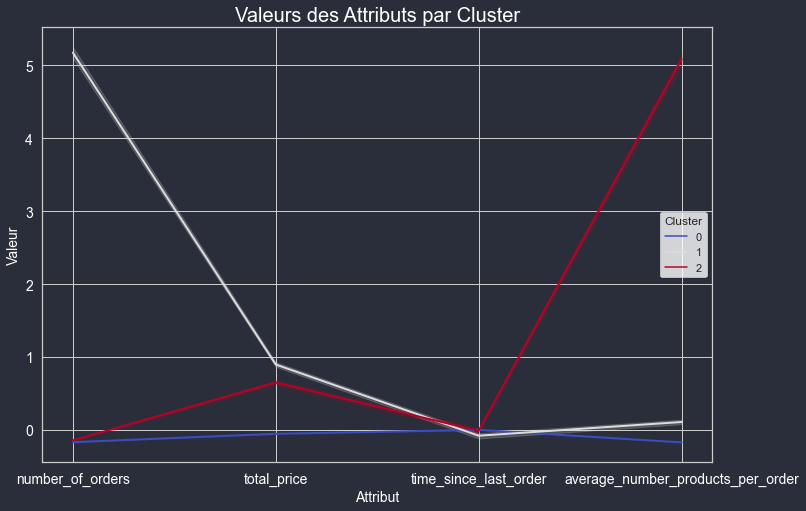

In [47]:
df_nor_melt1 = pd.melt(df_normalized1.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['number_of_orders', 'total_price', 'time_since_last_order', 
                                  'average_number_products_per_order'],
                      var_name='Attribute',
                      value_name='Value')

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt1, palette="coolwarm", linewidth=2 )

plt.title('Valeurs des Attributs par Cluster', fontsize=title_size, color=text_color)
plt.xlabel('Attribut', fontsize=label_size, color=text_color)
plt.ylabel('Valeur', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

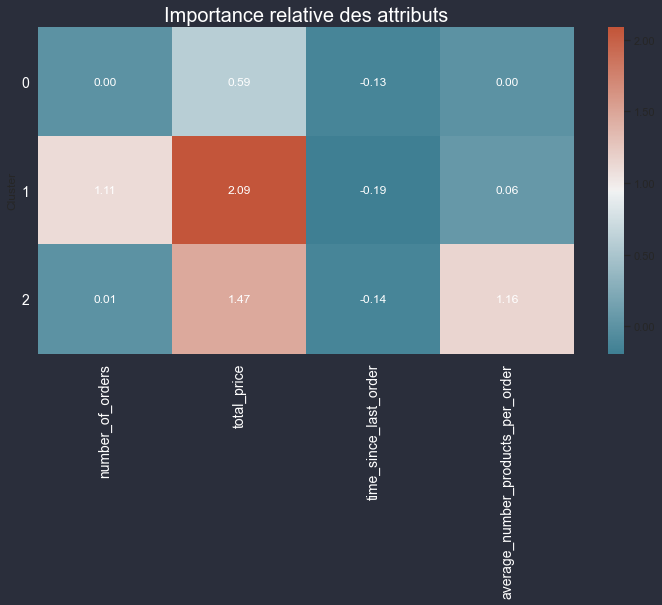

In [48]:
cluster_avg1 = data1[['Cluster','number_of_orders', 'total_price', 'time_since_last_order', 'average_number_products_per_order']].groupby(['Cluster']).mean()
population_avg1 = data1[['number_of_orders', 'total_price', 'time_since_last_order', 'average_number_products_per_order']].head().mean()

relative_imp1 = cluster_avg1 / population_avg1 - 1
relative_imp1.round(2)

cmap = sns.diverging_palette(220, 20, as_cmap=True)

plt.figure(figsize=(12, 6))
plt.gca().set_facecolor(background_color)

sns.heatmap(data=relative_imp1, annot=True, fmt='.2f', cmap=cmap, 
            cbar_kws={'format': '%.2f'}, annot_kws={'color': text_color})

plt.title('Importance relative des attributs', fontsize=title_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size, rotation=0)
plt.gcf().set_facecolor(background_color)

plt.show()

In [49]:
silhouette_avg1 = silhouette_score(data_transformed1, model1.labels_)
print(f"Coefficient de silhouette : {silhouette_avg1:.4f}")

Coefficient de silhouette : 0.6873


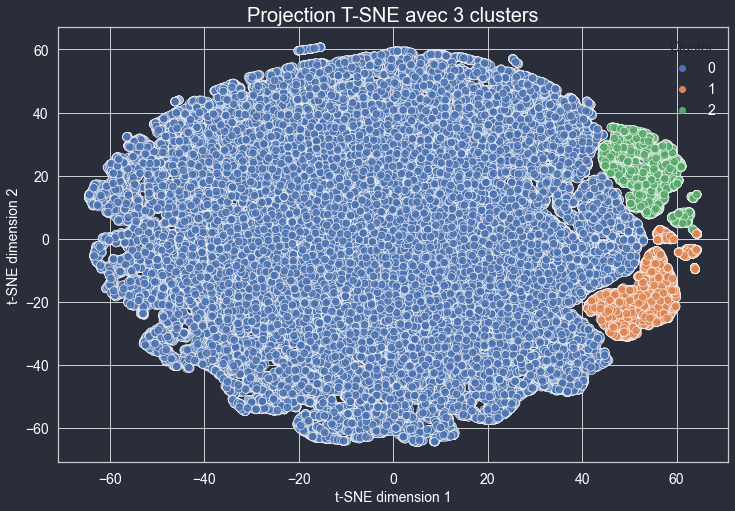

In [50]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

tsne = TSNE(n_components=2, init='pca', n_jobs=-1, random_state=42)
X_trans = tsne.fit_transform(data_transformed1)
X_trans = pd.DataFrame(X_trans)
X_trans["cluster"] = model1.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec 3 clusters", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

Le score silhouette est bon mais d'un point de vue métier le nombre de cluster semble trop faible pour permettre une segmentation assez précise des utilisateurs.

### 3.2.3 2ème modèle

**k-means avec 4 variables et k = 5**

In [51]:
data2 = data[['customer_unique_id', 'number_of_orders', 'total_price', 'average_number_products_per_order', 
              'delayed']]

In [52]:
log_columns = ["total_price"]
standardize_columns = ['number_of_orders', 'total_price', 'average_number_products_per_order', 'delayed']

data_transformed2 = transform_data(data2, log_columns, standardize_columns)

In [53]:
model2 = KMeans(n_clusters=5, random_state=42)
model2.fit(data_transformed2)
model2.labels_.shape

data2["Cluster"] = model2.labels_
data2.head()
data2.groupby('Cluster').agg({
    'delayed':'mean',
    'number_of_orders':'mean',
    'average_number_products_per_order':'mean',
    'total_price':['mean', 'count']}).round(1)

<ipython-input-53-42652b679c44>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



delayed number_of_orders average_number_products_per_order  \
           mean             mean                              mean   
Cluster                                                              
0           0.0              1.0                               1.0   
1           0.0              1.0                               1.0   
2           1.0              1.0                               1.0   
3           0.0              2.1                               1.1   
4           0.0              1.0                               2.2   

        total_price         
               mean  count  
Cluster                     
0             271.4  35891  
1              66.1  45634  
2             176.7   6073  
3             306.1   2896  
4             245.4   2853

In [54]:
df_normalized2 = pd.DataFrame(data_transformed2, columns=['number_of_orders', 'total_price', 'average_number_products_per_order', 'delayed'])
df_normalized2['ID'] = data2.index
df_normalized2['Cluster'] = model2.labels_

fig11 = df_normalized2.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()


fig11.rename(columns={'ID': 'Count'}, inplace=True)
fig11['percent'] = (fig11['Count'] / fig11['Count'].sum()) * 100
fig11['percent'] = fig11['percent'].round(1)

crest_palette = sns.color_palette("coolwarm", n_colors=5)  
colors = [mcolors.to_hex(color) for color in crest_palette]

fig = px.treemap(fig11, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution cluster")

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Distribution cluster", font=dict(size=20, color='white')), 
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

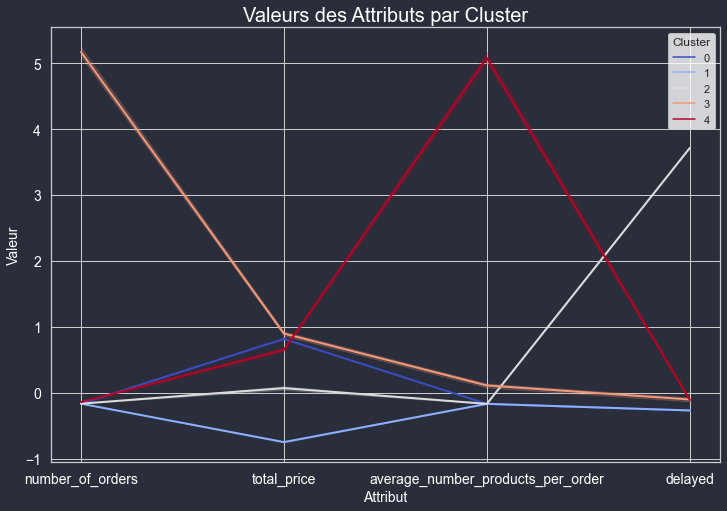

In [55]:
df_nor_melt2 = pd.melt(df_normalized2.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['number_of_orders', 'total_price', 'average_number_products_per_order', 
                                  'delayed'],
                      var_name='Attribute',
                      value_name='Value')

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt2, palette="coolwarm", linewidth=2 )

plt.title('Valeurs des Attributs par Cluster', fontsize=title_size, color=text_color)
plt.xlabel('Attribut', fontsize=label_size, color=text_color)
plt.ylabel('Valeur', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

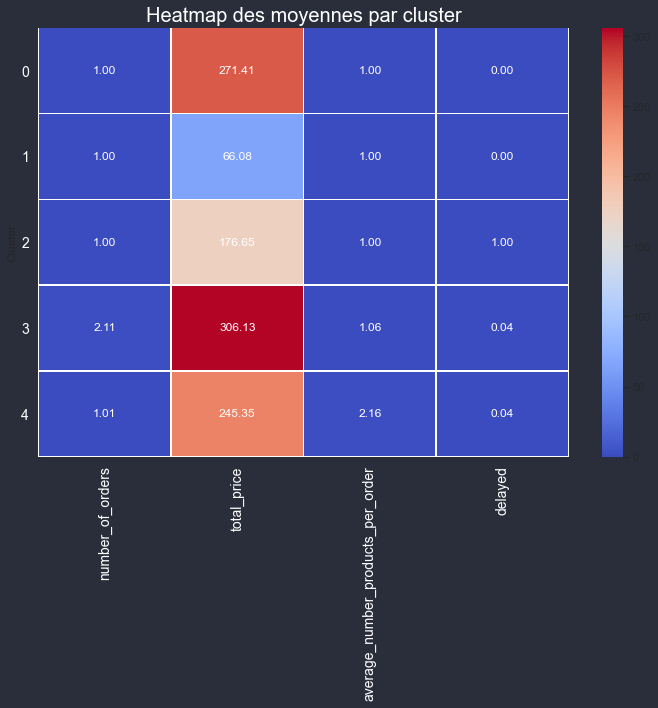

In [56]:
cluster_means0 = data2.groupby('Cluster').mean()

fig, ax = plt.subplots(figsize=(10, 10))
fig.patch.set_facecolor(background_color)

sns.heatmap(cluster_means0,  
            annot=True, 
            cmap='coolwarm', 
            cbar=True, 
            fmt=".2f", 
            ax=ax, 
            annot_kws={"size": 12, "color": text_color}, 
            linewidths=0.5)

ax.set_title('Heatmap des moyennes par cluster', fontsize=title_size, color=text_color)
ax.tick_params(axis='x', labelsize=label_size, colors=text_color)
ax.tick_params(axis='y', labelsize=label_size, colors=text_color)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)  
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)  

ax.set_facecolor(background_color)

plt.tight_layout()
plt.show()

In [57]:
silhouette_avg2 = silhouette_score(data_transformed2, model2.labels_)
print(f"Coefficient de silhouette : {silhouette_avg2:.4f}")

Coefficient de silhouette : 0.5664


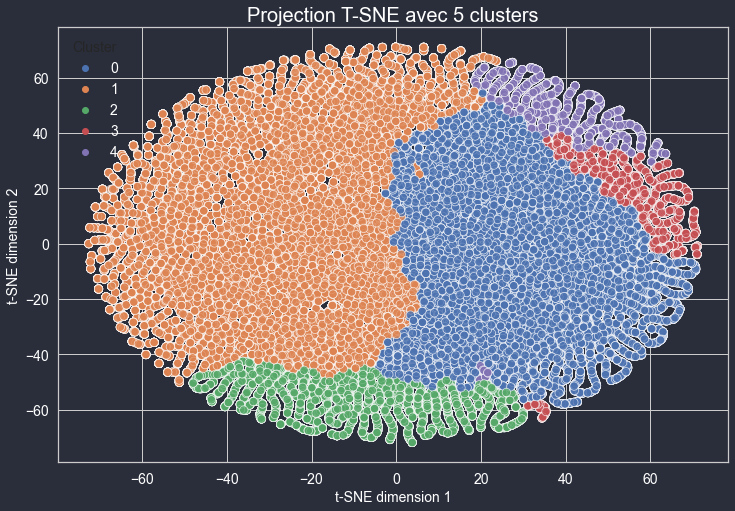

In [58]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

tsne = TSNE(n_components=2, perplexity=10, n_iter=1000, init='pca', n_jobs=-1, random_state=42)
X_trans = tsne.fit_transform(data_transformed2)
X_trans = pd.DataFrame(X_trans)
X_trans["cluster"] = model2.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec 5 clusters", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

Le score silhouette est bon cependant, d'un point de vue métier, l'absence de variable relative au temps depuis la dernière commande ne permettra pas d'identifier les nouveaux clients, les clients absents, etc..

### 3.2.4 3ème modèle 

**k-means avec 7 variables et k = 4**

In [59]:
data3 = data[['customer_unique_id', 'number_of_orders', 'total_price', 'time_since_last_order', 
              'average_number_products_per_order', 'average_delivery_time', 'average_review_score', 'delayed']]

In [60]:
log_columns = ['total_price', 'time_since_last_order','average_delivery_time']
standardize_columns = ['number_of_orders', 'total_price', 'time_since_last_order', 
                       'average_number_products_per_order', 'average_delivery_time', 'average_review_score', 
                       'delayed']

data_transformed3 = transform_data(data3, log_columns, standardize_columns)

In [61]:
model3 = KMeans(n_clusters=4, random_state=42)
model3.fit(data_transformed3)
model3.labels_.shape

data3["Cluster"] = model3.labels_

<ipython-input-61-715ee3ad8cfd>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [62]:
df_normalized3 = pd.DataFrame(data_transformed3, columns=['number_of_orders', 'total_price', 'time_since_last_order', 
              'average_number_products_per_order', 'average_delivery_time', 'average_review_score', 'delayed'])
df_normalized3['ID'] = data3.index
df_normalized3['Cluster'] = model3.labels_

fig12 = df_normalized3.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()


fig12.rename(columns={'ID': 'Count'}, inplace=True)
fig12['percent'] = (fig12['Count'] / fig12['Count'].sum()) * 100
fig12['percent'] = fig12['percent'].round(1)

crest_palette = sns.color_palette("coolwarm", n_colors=8)  
colors = [mcolors.to_hex(color) for color in crest_palette]

fig = px.treemap(fig12, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution cluster")

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Distribution cluster", font=dict(size=20, color='white')), 
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

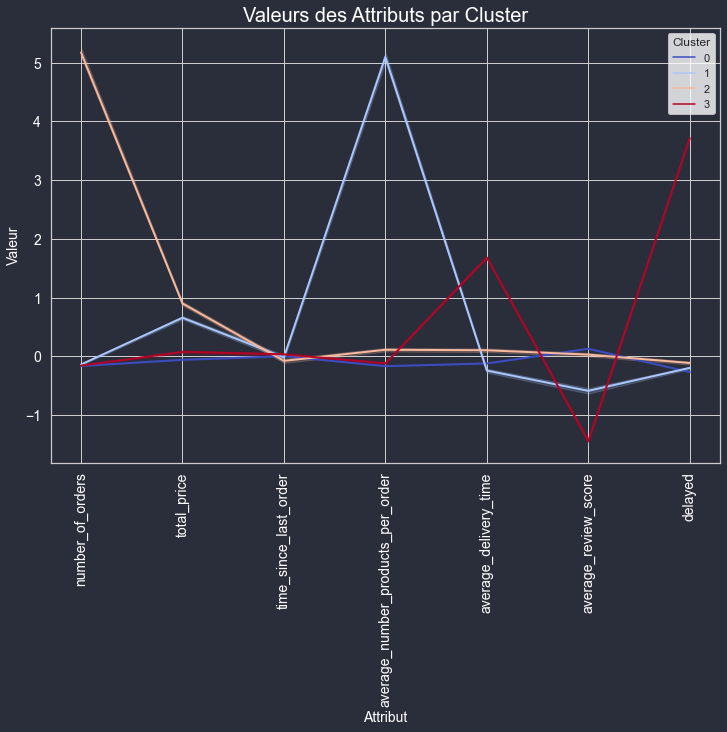

In [63]:
df_nor_melt3 = pd.melt(df_normalized3.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['number_of_orders', 'total_price', 'time_since_last_order',
                                  'average_number_products_per_order', 'average_delivery_time', 
                                  'average_review_score', 'delayed'],
                      var_name='Attribute',
                      value_name='Value')

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt3, palette="coolwarm", linewidth=2 )

plt.title('Valeurs des Attributs par Cluster', fontsize=title_size, color=text_color)
plt.xlabel('Attribut', fontsize=label_size, color=text_color)
plt.ylabel('Valeur', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size, rotation=90)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

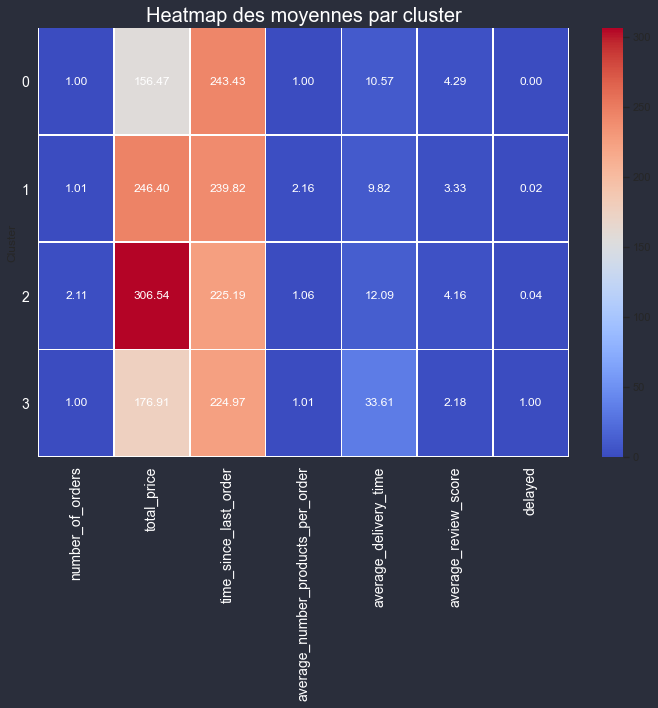

In [64]:
cluster_means = data3.groupby('Cluster').mean()

fig, ax = plt.subplots(figsize=(10, 10))
fig.patch.set_facecolor(background_color)

sns.heatmap(cluster_means,  
            annot=True, 
            cmap='coolwarm', 
            cbar=True, 
            fmt=".2f", 
            ax=ax, 
            annot_kws={"size": 12, "color": text_color}, 
            linewidths=0.5)

ax.set_title('Heatmap des moyennes par cluster', fontsize=title_size, color=text_color)
ax.tick_params(axis='x', labelsize=label_size, colors=text_color)
ax.tick_params(axis='y', labelsize=label_size, colors=text_color)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)  
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)  

ax.set_facecolor(background_color)

plt.tight_layout()
plt.show()

In [65]:
silhouette_avg3 = silhouette_score(data_transformed3, model3.labels_)
print(f"Coefficient de silhouette : {silhouette_avg3:.4f}")

Coefficient de silhouette : 0.5301


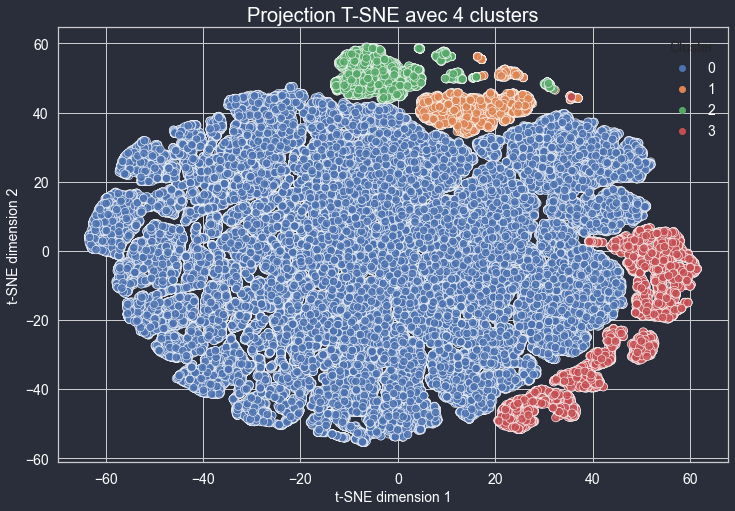

In [66]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

tsne = TSNE(n_components=2, init='pca', n_jobs=-1, random_state=42)
X_trans = tsne.fit_transform(data_transformed3)
X_trans = pd.DataFrame(X_trans)
X_trans["cluster"] = model3.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec 4 clusters", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

|   Cluster |   Type de clients    |   %    |    Interprétation    |   Actions à mener    |
|---|---|---|---|---|
|   0   |  Clients à ne pas perdre  |   87%  |  Clients qui ont peu commandé et dépensé peu d'argent mais qui ont été très satisfaits de leur commandes  |   faire des offres à durée limitée ; offrir des échantillons de produits gratuits ; relancer l'intérêt avec une campagne de sensibilisation  |     
|   1   |  Clients prometteurs  |   3%  |  Clients qui ont beaucoup dépensé mais qui n'ont pas passé un grand nombre de commande  |   faire des offres à durée limitée ; offrir des échantillons de produits gratuits  |
|   2   |  Clients loyaux  |   3%  |   Clients qui ont commandé récemment, qui ont ont dépensé le plus et qui sont revenu plusieurs fois   |  demander des avis ; les récompenser   | 
|   3   |  Clients à risque/perdus  |   7%  |  Clients qui n'ont pas beaucoup passé de commandes et qui ne sont pas satisfait de leur expérience (note faible, retard dans la livraison)  |  envoyer des e-mails personnalisés pour renouer ; proposer d'autres produits pertinents et des remises spéciales ; relancer l'intérêt avec une campagne de sensibilisation ; faire des offres à durée limitée   |  

### 3.2.5 4ème modèle 

**k-means avec 5 variables et k = 4**

In [67]:
data4 = data[['customer_unique_id', 'total_price', 'delayed', 'average_number_products_per_order', 
              'time_since_last_order', 'number_of_orders']]

In [68]:
log_columns = ['total_price', 'time_since_last_order']
standardize_columns = ['total_price', 'delayed', 'average_number_products_per_order', 
              'time_since_last_order', 'number_of_orders']

data_transformed4 = transform_data(data4, log_columns, standardize_columns)

In [69]:
model4 = KMeans(n_clusters=4, random_state=42)
model4.fit(data_transformed4)
model4.labels_.shape

data4["Cluster"] = model4.labels_

<ipython-input-69-4288f9e285a4>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [70]:
df_normalized4 = pd.DataFrame(data_transformed4, columns=['total_price', 'delayed', 
                                                          'average_number_products_per_order', 
                                                          'time_since_last_order', 'number_of_orders'])
df_normalized4['ID'] = data4.index
df_normalized4['Cluster'] = model4.labels_

fig13 = df_normalized4.groupby('Cluster').agg({'ID': lambda x: len(x)}).reset_index()


fig13.rename(columns={'ID': 'Count'}, inplace=True)
fig13['percent'] = (fig13['Count'] / fig13['Count'].sum()) * 100
fig13['percent'] = fig13['percent'].round(1)

crest_palette = sns.color_palette("coolwarm", n_colors=8)  
colors = [mcolors.to_hex(color) for color in crest_palette]

fig = px.treemap(fig13, path=['Cluster'],values='Count'
                 , width=800, height=400
                 ,title="Distribution cluster")

fig.update_layout(
    paper_bgcolor='#2a2e3b',  
    plot_bgcolor='#2a2e3b',   
    font=dict(color='white'),  
    title=dict(text="Distribution cluster", font=dict(size=20, color='white')), 
    treemapcolorway = colors, 
    margin = dict(t=50, l=25, r=25, b=25))

fig.data[0].textinfo = 'label+text+value+percent root'
fig.show()

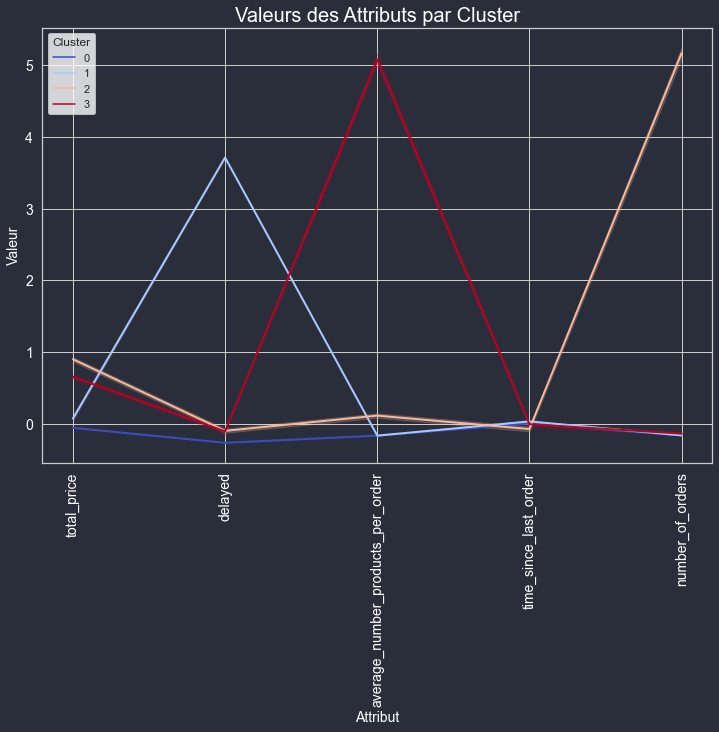

In [71]:
df_nor_melt4 = pd.melt(df_normalized4.reset_index(),
                      id_vars=['ID', 'Cluster'],
                      value_vars=['total_price', 'delayed', 'average_number_products_per_order', 
                                  'time_since_last_order', 'number_of_orders'],
                      var_name='Attribute',
                      value_name='Value')

plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

sns.lineplot(x='Attribute', y='Value', hue='Cluster', data=df_nor_melt4, palette="coolwarm", linewidth=2 )

plt.title('Valeurs des Attributs par Cluster', fontsize=title_size, color=text_color)
plt.xlabel('Attribut', fontsize=label_size, color=text_color)
plt.ylabel('Valeur', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size, rotation=90)
plt.yticks(color=text_color, fontsize=label_size)
plt.gcf().set_facecolor(background_color)

plt.show()

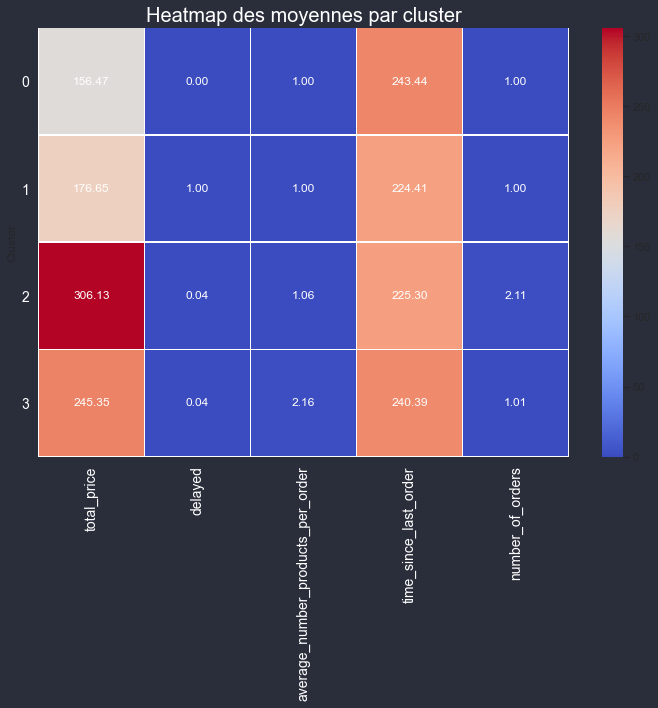

In [72]:
cluster_means1 = data4.groupby('Cluster').mean()

fig, ax = plt.subplots(figsize=(10, 10))
fig.patch.set_facecolor(background_color)

sns.heatmap(cluster_means1,  
            annot=True, 
            cmap='coolwarm', 
            cbar=True, 
            fmt=".2f", 
            ax=ax, 
            annot_kws={"size": 12, "color": text_color}, 
            linewidths=0.5)

ax.set_title('Heatmap des moyennes par cluster', fontsize=title_size, color=text_color)
ax.tick_params(axis='x', labelsize=label_size, colors=text_color)
ax.tick_params(axis='y', labelsize=label_size, colors=text_color)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)  
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)  

ax.set_facecolor(background_color)

plt.tight_layout()
plt.show()

In [73]:
silhouette_avg4 = silhouette_score(data_transformed4, model4.labels_)
print(f"Coefficient de silhouette : {silhouette_avg4:.4f}")

Coefficient de silhouette : 0.6060


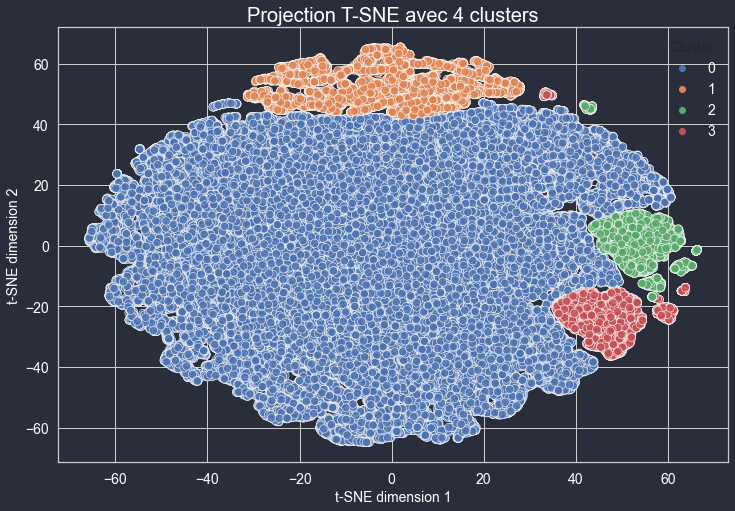

In [74]:
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

tsne = TSNE(n_components=2, init='pca', n_jobs=-1, random_state=42)
X_trans = tsne.fit_transform(data_transformed4)
X_trans = pd.DataFrame(X_trans)
X_trans["cluster"] = model4.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec 4 clusters", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

|   Cluster |   Type de clients    |   %    |    Interprétation    |   Actions à mener    |
|---|---|---|---|---|
|   0   |  Clients à ne pas perdre  |   87%  |  Clients qui ont peu commandé et dépensé peu d'argent  |   faire des offres à durée limitée; proposer d'autres produits pertinents et des remises spéciales ; relancer l'intérêt avec une campagne de sensibilisation  |     
|   1   |  Clients à risque  |   7%  |  Clients qui ont commandé une seule fois, qui ont donc peu dépensé et dont la commande a été livré en retard ce qui peut tendre vers une mauvaise expérience de leur part.   |  envoyer des e-mails personnalisés pour renouer ; offrir des échantillons de produits gratuits ; proposer d'autres produits pertinents et des remises spéciales ; relancer l'intérêt avec une campagne de sensibilisation ; faire des offres à durée limitée  |
|   2   |  Clients loyaux  |   3%  |   Clients qui ont commandé récemment, qui ont ont dépensé le plus et qui sont revenu plusieurs fois   |  demander des avis ; les récompenser   | 
|   3   |  Clients prometteurs  |   3%  |  Clients qui ont beaucoup dépensé (grosse commande) mais qui n'ont pas passé un grand nombre de commande  |   faire des offres à durée limitée ; offrir des échantillons de produits gratuits, relancer l'intérêt avec une campagne de sensibilisation  |  

### Conclusion k-means



|   Modèle |   Nombre de clusters   |    Score Silhouette   |   Notes   |
|---|---|---|---|
|   1   |  3  |  0.6873   |  Bon score silhouette. D'un point de vu métier le nombre de clusters est peut être trop faible et ne permet pas une segmentation assez précise de la clientèle.  |     
|   2   |  5  |  0.5664   |  Assez bon score silhouette. D'un point de vue métier, l'interprétation des clusters est à améliorer car l'absence de variable relative au temps ne permet pas d'identifier les nouveaux clients, les clients absents, etc. |     
|   3   |  4  |  0.5301   |  Assez bon score silhouette. D'un point de vue métier nous avons 4 clusters qui sont facilement interprétables. |      
|   4   |  4  |  0.6060   |  Bon score silhouette. D'un point de vue métier nous avons 4 clusters qui sont assez facilement interprétables.    |    

Finalement les modèles n°3 et 4 sont les plus pertinents. Nous retiendrons le dernier pour la suite à cause de son meilleur score silhouette.

## 3.3 DBSCAN

Nous allons tester un autre algorithme de clustering puis comparer les résultats avec le modèle k-means retenu ci-dessus.

In [75]:
def grid_search_dbscan(data, eps_values, min_samples_values):
    best_model = None
    best_score = -1
    best_params = {}
    results = []

    param_grid = ParameterGrid({"eps": eps_values, "min_samples": min_samples_values})

    for params in param_grid:
        model = DBSCAN(eps=params["eps"], min_samples=params["min_samples"], n_jobs=-1)
        labels = model.fit_predict(data)

        # Ignorer les configurations où tous les points sont considérés comme du bruit
        if len(set(labels)) <= 1:
            continue

        score = silhouette_score(data, labels)
        results.append((params, score))

        if score > best_score:
            best_model = model
            best_score = score
            best_params = params

    return best_model, best_score, best_params, results

# optimisation des hyperparamètres par recherche de grille
eps_values = [0.1, 0.2, 0.5, 0.7, 1.0]
min_samples_values = [3, 5, 10, 15]
best_model, best_score, best_params, results = grid_search_dbscan(data_transformed3, eps_values, min_samples_values)

print(f"Meilleurs paramètres: {best_params}")
print(f"Meilleur coefficient de silhouette: {best_score:.4f}")


data3["Cluster"] = best_model.labels_

Meilleurs paramètres: {'eps': 1.0, 'min_samples': 10}
Meilleur coefficient de silhouette: 0.4205


<ipython-input-75-ba1b6ad46745>:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



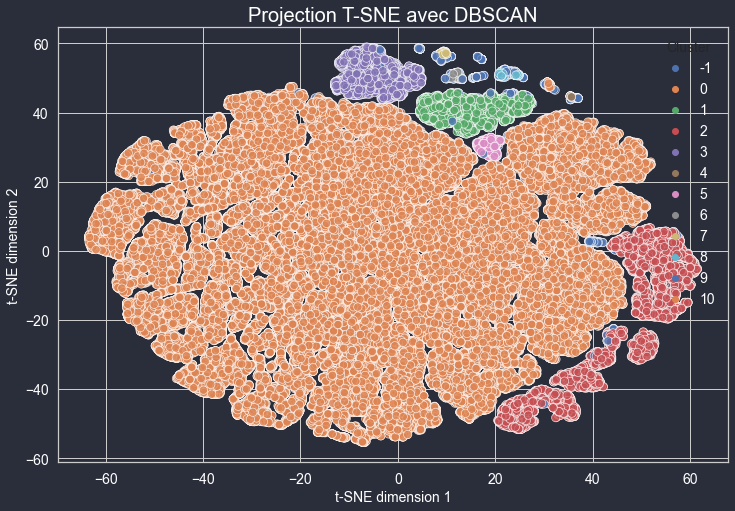

In [76]:
# t-SNE
plt.figure(figsize=(12, 8))
plt.gca().set_facecolor(background_color)

tsne = TSNE(n_components=2, init='pca', n_jobs=-1, random_state=42)
X_trans = tsne.fit_transform(data_transformed3)
X_trans = pd.DataFrame(X_trans)
X_trans["cluster"] = best_model.labels_
sns.scatterplot(data=X_trans, x=0, y=1, hue='cluster', palette="deep", s=70, alpha=0.8)

plt.title("Projection T-SNE avec DBSCAN", fontsize=title_size, color=text_color)
plt.xlabel('t-SNE dimension 1', fontsize=label_size, color=text_color)
plt.ylabel('t-SNE dimension 2', fontsize=label_size, color=text_color)
plt.xticks(color=text_color, fontsize=label_size)
plt.yticks(color=text_color, fontsize=label_size)
plt.legend(title='Cluster', title_fontsize=label_size, fontsize=label_size, loc='best', frameon=False, labelcolor=text_color)
plt.gcf().set_facecolor(background_color)

plt.show()

DBSCAN retourne un score silhouette plus faible que le modèle k-means sélectionné. De plus 12 clusters ont été créé avec ce modèle DBSCAN. 

## 4. Conclusion

Après avoir effectuer une segmentation RFM sur nos données nous avons testé plusieurs modèles de clustering incluant davantage de variables. Finalement, le modèle retenu est k-means avec k=4 qui prend en compte les varaibles relatives au nombre de commandes, au prix total dépensé, au temps depuis la dernière commande, au nombre moyen de produit dans les commandes et au fait qu'il y ait eu du retard ou non pour la livraison.

Dans le notebook suivannt nous effectuerons une simulation d'évolution de la stabilité du clustering sur différentes périodes.